<a href="https://colab.research.google.com/github/SarahY89/GHANA-TRADE-DATA-ANALYSIS/blob/main/expreso_churn_prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>





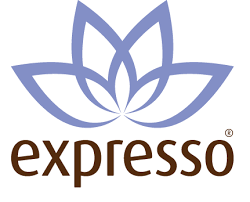

 ## Problem
Portrait
Expresso is an African telecommunications company that provides customers with airtime and mobile data bundles. The objective of this challenge is to develop a machine learning model to predict the likelihood of each Expresso customer “churning” .

Customer churn is the marketing term, which is used when an existing customer stops to buying a company's products or exit to use their services. When hurn occers, the customer chooses to cut his ties with the company. That's why churn usually is a huge problem for companies's marketing team. In this case, we define a churn customer as someone who is becoming inactive and not making any transactions for 90 days.


# EXPLORATORY DATA ANALYSIS

In [1]:
!pip install plotly

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import plotly.graph_objects as go

df = pd.read_csv('/content/Train.csv')

total_customers = len(df)
retained_customers = len(df[df['CHURN'] == 0])
churned_customers = len(df[df['CHURN'] == 1])
churn_rate = churned_customers / total_customers * 100

fig = go.Figure()

# Total Customers
fig.add_trace(go.Indicator(
    mode="number",
    value=total_customers,
    title="Total Customers",
    number={'font': {'size': 25}},
    domain={'x': [0, 0.25], 'y': [0, 1]}
))

# Retained Customers
fig.add_trace(go.Indicator(
    mode="number",
    value=retained_customers,
    title="Retained Customers",
#    titlefont={'size': 12, 'font-weight': 'bold'},
    number={'font': {'size': 25}},
    domain={'x': [0.3, 0.55], 'y': [0, 1]}
))

# Churned Customers
fig.add_trace(go.Indicator(
    mode="number",
    value=churned_customers,
    title="Churned Customers",
    number={'font': {'size': 25}},
    domain={'x': [0.6, 0.85], 'y': [0, 1]}
))

# Churn Rate
fig.add_trace(go.Indicator(
    mode="number+delta",
    value=churn_rate,
    title="Churn Rate",
    number={'font': {'size': 20}, 'suffix': '%'},
    delta={'reference': 0, 'relative': False, 'position': "bottom"},
    domain={'x': [0.9, 1], 'y': [0, 1]}
))

fig.update_layout(width=1000, height=100, margin=dict(t=50, b=50, l=10, r=10))
fig.show()

In [2]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 427177 entries, 0 to 427176
Data columns (total 19 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   user_id         427177 non-null  object 
 1   REGION          258621 non-null  object 
 2   TENURE          427177 non-null  object 
 3   MONTANT         277096 non-null  float64
 4   FREQUENCE_RECH  277096 non-null  float64
 5   REVENUE         283260 non-null  float64
 6   ARPU_SEGMENT    283260 non-null  float64
 7   FREQUENCE       283260 non-null  float64
 8   DATA_VOLUME     216905 non-null  float64
 9   ON_NET          271071 non-null  float64
 10  ORANGE          249485 non-null  float64
 11  TIGO            171569 non-null  float64
 12  ZONE1           33776 non-null   float64
 13  ZONE2           27122 non-null   float64
 14  MRG             427177 non-null  object 
 15  REGULARITY      427177 non-null  int64  
 16  TOP_PACK        248395 non-null  object 
 17  FREQ_TOP_P

In [3]:
df.head(10)

churned_df = df[df['CHURN'] == 1]

print(churned_df.head(10))

                                     user_id REGION         TENURE  MONTANT  \
1   00000cb4a5d760de88fecb38e2f71b7bec52e834    NaN  I 18-21 month      NaN   
12  000068fe2aad763fb2667d253fa4c9e19e3b0636    NaN  G 12-15 month      NaN   
17  0000a45ed15492427df603217166f1f813a2cc83    NaN  H 15-18 month      NaN   
21  0000b00bed6ad90fd35d1957f484f9e54990c714    NaN  I 18-21 month      NaN   
22  0000b4af921db374095a9e7ab87ee314522e4fe4    NaN   K > 24 month      NaN   
35  00012873b0a82e81b3155431769fa5ac0a8ac267    NaN   K > 24 month      NaN   
40  00013be0551465ba9cd686f10aa2f0a4f67f4fe6    NaN   K > 24 month   6300.0   
51  0001b56565732f8d0291ccac6c9d6d8ff10695b8    NaN   K > 24 month      NaN   
52  0001b59420394aa028655cfecc56a157671c2b8d    NaN   K > 24 month      NaN   
54  0001c6f26a2b2a44835e332328b300875e7ff243    NaN   K > 24 month      NaN   

    FREQUENCE_RECH  REVENUE  ARPU_SEGMENT  FREQUENCE  DATA_VOLUME  ON_NET  \
1              NaN      NaN           NaN        NaN 

In [4]:
df.describe()

,MONTANT,FREQUENCE_RECH,REVENUE,ARPU_SEGMENT,FREQUENCE,DATA_VOLUME,ON_NET,ORANGE,TIGO,ZONE1,ZONE2,REGULARITY,FREQ_TOP_PACK,CHURN
count,277096.000000,277096.000000,283260.000000,283260.000000,283260.000000,216905.000000,271071.000000,249485.000000,171569.000000,33776.000000,27122.000000,427177.000000,248394.000000,427176.000000
mean,5549.418512,11.565584,5520.035568,1840.018213,14.008370,3364.095475,279.676967,95.964054,23.098456,8.221163,7.382568,28.051992,9.287942,0.187438
std,7196.532130,13.295966,7209.197300,2403.061910,14.718777,12232.199208,881.988895,205.906041,63.384137,42.355318,30.325759,22.284285,12.253318,0.390263
min,10.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000
25%,1000.000000,2.000000,1000.000000,333.000000,3.000000,0.000000,5.000000,7.000000,2.000000,0.000000,0.000000,6.000000,2.000000,0.000000
50%,3000.000000,7.000000,3000.000000,1000.000000,9.000000,265.000000,27.000000,29.000000,6.000000,1.000000,2.000000,24.000000,5.000000,0.000000
75%,7400.000000,16.000000,7399.000000,2466.000000,20.000000,2912.000000,158.000000,99.000000,20.000000,4.000000,5.000000,51.000000,12.000000,0.000000
max,470000.000000,133.000000,532177.000000,177392.000000,91.000000,990644.000000,50809.000000,6555.000000,3486.000000,2507.000000,1346.000000,62.000000,592.000000,1.000000


# Feature Field Analysis

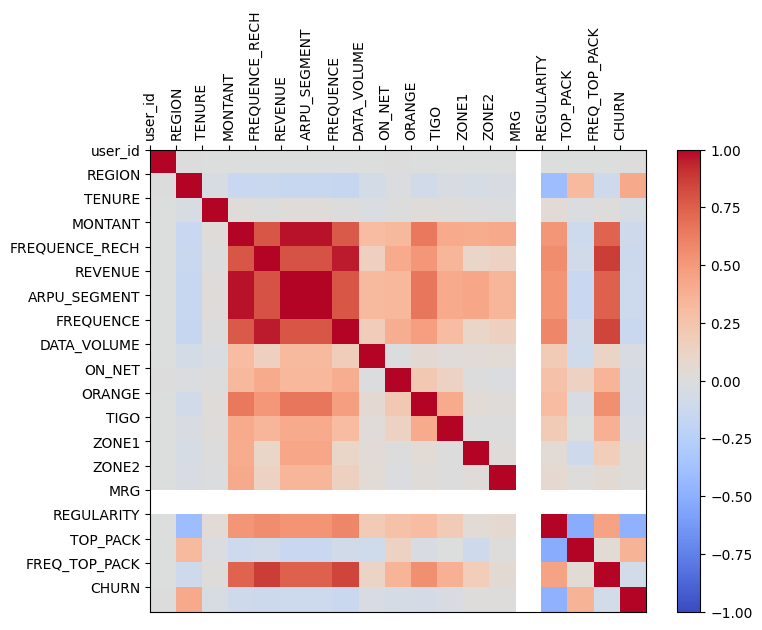

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder

df2 = df.copy()  # Make a copy before we do convert

cat_cols = df.select_dtypes(include=['object']).columns.tolist()

for col in cat_cols:
    le = LabelEncoder()
    df2[col] = le.fit_transform(df2[col])

corr = df2.corr()

fig, ax = plt.subplots(figsize=(8,6))
heatmap = ax.pcolor(corr, cmap='coolwarm', vmin=-1, vmax=1)

ax.set_xticks(range(len(corr.columns)))
ax.set_yticks(range(len(corr.columns)))
ax.set_xticklabels(corr.columns, rotation=90)
ax.set_yticklabels(corr.columns)
ax.invert_yaxis()
ax.xaxis.tick_top()

cbar = plt.colorbar(heatmap)
plt.show()

In [6]:
import pandas as pd
import plotly.express as px

fig = px.histogram(df, x="REGION", color="CHURN", barmode="group")
fig.update_traces(textposition='auto', hovertemplate='%{x}<br>%{y}')
#fig.update_layout(width=600, height=400)
fig.show()

fig = px.histogram(df, x="TENURE", color="CHURN", barmode="group")
fig.update_traces(textposition='auto', hovertemplate='%{x}<br>%{y}')
#fig.update_layout(width=600, height=400)
fig.show()

fig = px.histogram(df, x="TOP_PACK", color="CHURN", barmode="group")
fig.update_traces(textposition='auto', hovertemplate='%{x}<br>%{y}')
#fig.update_layout(width=600, height=400)
fig.show()

fig = px.histogram(df, x="REGULARITY", color="CHURN", barmode="group")
fig.update_traces(textposition='auto', hovertemplate='%{x}<br>%{y}')
#fig.update_layout(width=600, height=400)
fig.show()

In [7]:
!pip install seaborn

# Assuming your DataFrame is named df
distinct_tenure_values = df.TENURE.unique()
print(distinct_tenure_values)

# tenure_counts = df.TENURE.value_counts()

# plt.figure(figsize=(10, 5))
# tenure_counts.plot.pie(autopct='%.1f%%', startangle=90)
# plt.title("Tenure Distribution")
# plt.ylabel("")
# plt.show()

['K > 24 month' 'I 18-21 month' 'G 12-15 month' 'H 15-18 month'
 'J 21-24 month' 'F 9-12 month' 'D 3-6 month' 'E 6-9 month']


# DATA PREPROCESSING

In [8]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

#import seaborn as sns
import matplotlib.pyplot as plt

import os
#for dirname, _, filenames in os.walk('/kaggle/input'):
#    for filename in filenames:
#        print(os.path.join(dirname, filename))

df = pd.read_csv('/content/Train.csv')

In [9]:
from sklearn.preprocessing import LabelEncoder

def preprocess_data(df):
    # Replace missing values in numeric columns with mean
    for column in df.select_dtypes(include=[np.number]).columns:
        df[column].fillna(df[column].mean(), inplace=True)

    # Replace missing values in categorical columns with most frequent category
    for column in df.select_dtypes(include=["object"]).columns:
        df[column].fillna(df[column].mode().iloc[0], inplace=True)

    # Check duplicates
    #print(f"Number of duplicate rows: {df.duplicated().sum()}")
    df = df.drop_duplicates()

    # Drop the 'user_id' column, if it exists
    df = df.drop(['user_id'], axis=1, errors='ignore')

    # Label encoding
    le = LabelEncoder()
    df.MRG = le.fit_transform(df.MRG)
    df.TENURE = le.fit_transform(df.TENURE)
    df.REGION = le.fit_transform(df.REGION)
    df.TOP_PACK = le.fit_transform(df.TOP_PACK)

    return df

df = preprocess_data(df)

In [10]:
from sklearn.model_selection import train_test_split

# sperate variables and prediction
y = df['CHURN']
x = df.drop(['CHURN'], axis=1, errors='ignore')

x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.8,random_state=1000)

# DATA MODELING

In [11]:
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score

lr_model = LogisticRegression(max_iter=1000)

scaler = StandardScaler()
x_train_scaled = scaler.fit_transform(x_train)
x_test_scaled = scaler.transform(x_test)

lr_model = LogisticRegression()
lr_model.fit(x_train_scaled, y_train)
y_prob_lr = lr_model.predict_proba(x_test_scaled)[:, 1]

print("ROC with Logistic Regression:", roc_auc_score(y_test, y_prob_lr))

ROC with Logistic Regression: 0.908231697820554


# DECISION TREE MODEL

In [12]:
from sklearn.tree import DecisionTreeClassifier

dc_model = DecisionTreeClassifier()
dc_model.fit(x_train,y_train)

y_prob_dc = dc_model.predict_proba(x_test)[:,1]
print("ROC with Decision Tree Model:",roc_auc_score(y_test,y_prob_dc))

ROC with Decision Tree Model: 0.8288878088654675


# BAYES MODEL

In [13]:
from sklearn.naive_bayes import GaussianNB
nb_model = GaussianNB()
nb_model.fit(x_train,y_train)
y_prob_nb = nb_model.predict_proba(x_test)[:,1]
print("ROC by Naive Bayes:",roc_auc_score(y_test,y_prob_nb))

ROC by Naive Bayes: 0.8897209832182325


# KNN

In [14]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import roc_auc_score

knn_model = KNeighborsClassifier(n_neighbors=3)
knn_model.fit(x_train, y_train)
y_prob_knn = knn_model.predict_proba(x_test)[:, 1]
print("ROC by K-Nearest Neighbors:", roc_auc_score(y_test, y_prob_knn))

ROC by K-Nearest Neighbors: 0.8069129051208005


# RANDOM FOREST

In [15]:
from sklearn.ensemble import RandomForestRegressor

rfr_model = RandomForestRegressor()
rfr_model.fit(x_train,y_train)
y_prob_rfr = rfr_model.predict(x_test)
print("ROC by RandomForest:",roc_auc_score(y_test,y_prob_rfr))

ROC by RandomForest: 0.9029783967287648


# ABABOOST

In [16]:
from sklearn.ensemble import AdaBoostClassifier

AB_model = AdaBoostClassifier(random_state=2022)
AB_model.fit(x_train,y_train)
y_prob_AB = AB_model.predict_proba(x_test)[:,1]
print("ROC by AdaBoost:",roc_auc_score(y_test,y_prob_AB))

ROC by AdaBoost: 0.9147930591118731


# Gradient Boosting

In [17]:
from sklearn.ensemble import GradientBoostingClassifier
GBDT_model = GradientBoostingClassifier(random_state=2022)
GBDT_model.fit(x_train,y_train)
y_prob_GBDT = GBDT_model.predict_proba(x_test)[:,1]
print("RUC by AdaBoost:",roc_auc_score(y_test,y_prob_GBDT))

RUC by AdaBoost: 0.9165784105467552


# Model Optimization

In [18]:
from tabulate import tabulate

roc_data = pd.DataFrame([['Logistic Regression', roc_auc_score(y_test, y_prob_lr)],
                         ['Decision Tree', roc_auc_score(y_test, y_prob_dc)],
                         ['Bayes', roc_auc_score(y_test, y_prob_nb)],
                         ['K Neighbors', roc_auc_score(y_test, y_prob_knn)],
                         ['Random Forest', roc_auc_score(y_test, y_prob_rfr)],
                         ['AdaBoost', roc_auc_score(y_test, y_prob_AB)],
                         ['GBDT', roc_auc_score(y_test, y_prob_GBDT)]],
                        columns=['Algorithm', 'ROC AUC Score'])

print(tabulate(roc_data, headers='keys', tablefmt='pretty', showindex=False))

+---------------------+--------------------+
|      Algorithm      |   ROC AUC Score    |
+---------------------+--------------------+
| Logistic Regression | 0.908231697820554  |
|    Decision Tree    | 0.8288878088654675 |
|        Bayes        | 0.8897209832182325 |
|     K Neighbors     | 0.8069129051208005 |
|    Random Forest    | 0.9029783967287648 |
|      AdaBoost       | 0.9147930591118731 |
|        GBDT         | 0.9165784105467552 |
+---------------------+--------------------+


In [19]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import AdaBoostClassifier

parameters = {
    'n_estimators': range(10, 150, 10),
    'learning_rate': [0.01, 0.025, 0.05, 0.075, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35, 0.4],
}

AB_model = AdaBoostClassifier()
grid_search = GridSearchCV(AB_model, parameters, scoring='roc_auc', cv=5, n_jobs=-1)
grid_search.fit(x_train, y_train)
grid_search.best_params_

{'learning_rate': 0.1, 'n_estimators': 140}

In [20]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import roc_auc_score

# Replace these parameters with the ones you found using GridSearchCV
best_n_estimators = 140
best_learning_rate = 0.1

AB_model_best = AdaBoostClassifier(n_estimators=best_n_estimators, learning_rate=best_learning_rate, random_state=2022)
AB_model_best.fit(x_train, y_train)
y_prob_ab_best = AB_model_best.predict_proba(x_test)[:, 1]
print("AdaBoost algorithm ROC score:", roc_auc_score(y_test, y_prob_ab_best))

AdaBoost algorithm ROC score: 0.915068316608019


In [ ]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import roc_auc_score, roc_curve, f1_score, accuracy_score

y_pred_ab_best = AB_model_best.predict(x_test)  # Compute the predicted class labels

print("AdaBoost algorithm ROC score:", roc_auc_score(y_test, y_prob_ab_best))

# Calculate the ROC curve and F1 score
fpr, tpr, _ = roc_curve(y_test, y_prob_ab_best)
f1 = f1_score(y_test, y_pred_ab_best)

# Create the ROC curve plot
plt.figure(figsize=(9, 5))

plt.plot(fpr, tpr, label=f'ROC AUC = {roc_auc_score(y_test, y_prob_ab_best):.2f}')
plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower right")

In [25]:
!pip install openpyxl

features = x.columns
importances = AB_model_best.feature_importances_

# Remove this line to fix the error
# importances = np.append(importances, 0)

feat_importances = pd.DataFrame()
feat_importances['Feature Name'] = features
feat_importances['Feature Importance'] = importances

feat_importances.sort_values('Feature Importance',ascending=False).to_excel('User_Churn_AdaBoost_Feature_Importance.xlsx')

# Print fancy table
sorted_feat_importances = feat_importances.sort_values('Feature Importance', ascending=False)
print(tabulate(sorted_feat_importances, headers='keys', tablefmt='pretty', showindex=False))

+----------------+---------------------+
|  Feature Name  | Feature Importance  |
+----------------+---------------------+
|   REGULARITY   | 0.32857142857142857 |
|     REGION     | 0.16428571428571428 |
|     ORANGE     | 0.10714285714285714 |
|    MONTANT     | 0.07142857142857142 |
|  DATA_VOLUME   | 0.06428571428571428 |
|     ON_NET     | 0.06428571428571428 |
|     TENURE     | 0.05714285714285714 |
|    REVENUE     | 0.04285714285714286 |
|   FREQUENCE    | 0.02857142857142857 |
|      TIGO      | 0.02857142857142857 |
|     ZONE1      | 0.02142857142857143 |
| FREQ_TOP_PACK  | 0.02142857142857143 |
|  ARPU_SEGMENT  |         0.0         |
|     ZONE2      |         0.0         |
|      MRG       |         0.0         |
| FREQUENCE_RECH |         0.0         |
|    TOP_PACK    |         0.0         |
+----------------+---------------------+


# Prediction

In [26]:
from sklearn.preprocessing import LabelEncoder
import pandas as pd

test_data = pd.read_csv('/content/Test.csv')

# Save the user_id column before preprocessing
user_ids = test_data['user_id']

test_data = preprocess_data(test_data)

predictions = AB_model_best.predict(test_data)

submission = pd.DataFrame({'user_id': user_ids, 'CHURN': predictions.astype(int)})
submission.to_csv('submission.csv', index=False)
churned_count = (predictions == 1).sum()
total_count = len(predictions)
churned_percentage = (churned_count / total_count) * 100

print("Churned percentage: {:.2f}%".format(churned_percentage))

test_data['CHURN'] = predictions
sorted_test_data = test_data.sort_values(by='CHURN', ascending=False)

# Display the top 10 rows
print(sorted_test_data.head(10))

Churned percentage: 12.81%
        REGION  TENURE      MONTANT  FREQUENCE_RECH      REVENUE  \
57707        0       7  5524.958826       11.519853  5499.680468   
243540       0       7  5524.958826       11.519853  5499.680468   
156825       0       7  5524.958826       11.519853  5499.680468   
61094        0       7  5524.958826       11.519853  5499.680468   
61095        0       7  5524.958826       11.519853  5499.680468   
327015       0       7  5524.958826       11.519853  5499.680468   
156824       0       7  5524.958826       11.519853  5499.680468   
243531       0       7  5524.958826       11.519853  5499.680468   
243532       0       6  5524.958826       11.519853  5499.680468   
243533       0       7  5524.958826       11.519853  5499.680468   

        ARPU_SEGMENT  FREQUENCE  DATA_VOLUME     ON_NET     ORANGE       TIGO  \
57707    1833.232443  13.957963  3346.095454  278.80631  95.193008  23.052088   
243540   1833.232443  13.957963  3346.095454  278.80631  95.19